<a id='top'></a>
<div class="list-group" id="list-tab" role="tablist">
<p style="background-color:#FFC300;font-family:sans-serif;color:#FFFFFF;font-size:250%;text-align:center;border-radius:15px 15px;">SMOKING SIGNAL OF BODY</p>

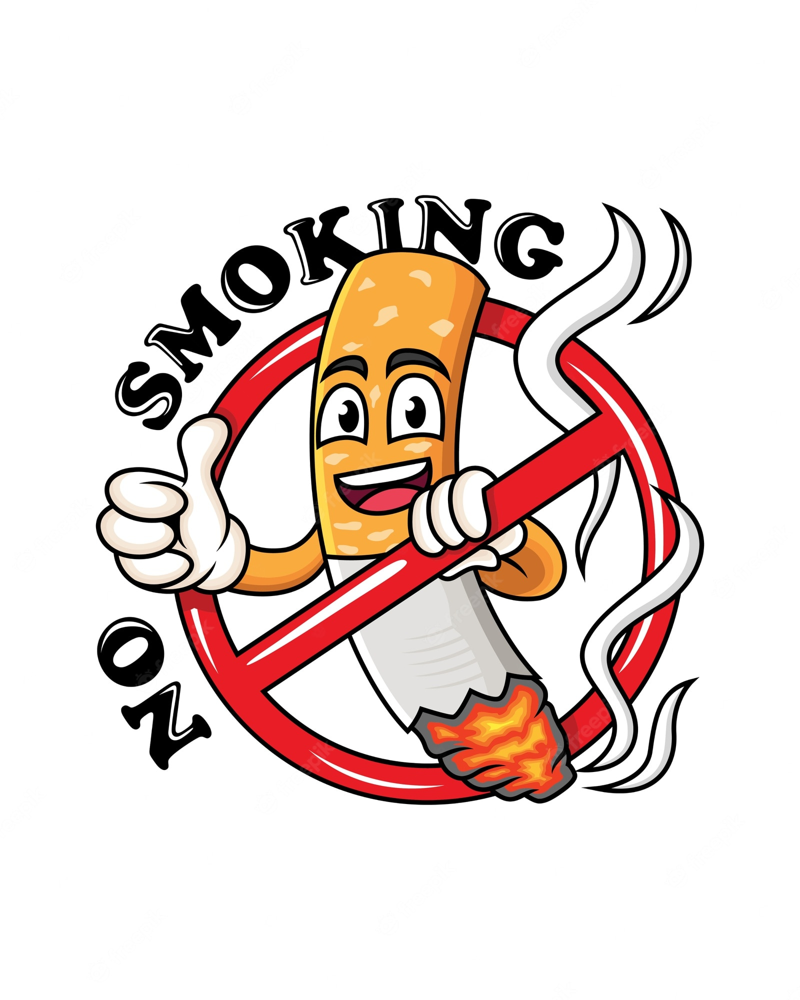

   <a id='top'></a>
<div class="list-group" id="list-tab" role="tablist">
<p style="background-color:#ffc300;font-family:sans-serif;color:#FFF9ED;font-size:200%;text-align:center;border-radius:9px 9px;">TABLE OF CONTENTS</p>   
    
* [1. INTRODUCTION](#1)
    
* [2. IMPORT NECESSARY LIBRARIES](#2)
    
* [3. LOADING DATASET](#3)
    
* [4. INITIAL INFORMATION ABOUT DATASET](#4)
    
    * [4.1. Change Column Names](#4.1)    
    * [4.2. Basic Information About Dataset](#4.2)    
    * [4.3. Check null Values](#4.3)    
    * [4.4. Descriptive Statistics of Numeric Variables](#4.4)    
    
    
    
* [5. DATA VISUALIZATION](#5)
    
    * [5.1. Correlation and Heatmap](#5.1)    
    * [5.2. Pie Chart](#5.2)    
    * [5.3. Barplot](#5.3)    
    * [5.4. Catplot](#5.4)
    * [5.5. Pairplot](#5.5)
    * [5.6. Scatterplot](#5.6)
    * [5.7. Distplot](#5.7)
    * [5.8. Regplot](#5.8)
    * [5.9. 2D Histogram](#5.9)
    * [5.10. Pandas Crosstab](#5.10)
    * [5.11. Smooth Kernel Density With Marginal Histograms](#5.11)
    * [5.12. Visualization with Plotly Express](#5.12)
    
    
    
* [6. DATASET PREPROCESSİNG](#6)
    
    * [6.1. Look at Dataset and drop outliers](#6.1)    
    * [6.2. Encode Categoric Variables](#6.2)    
    * [6.3. Select Dependent and Independent Variables](#6.3)    
    * [6.4. Split the Dataset into Train and Test Sets](#6.4)
    * [6.5. Standardization process](#6.5)

    
    
* [7. BUİLDİNG CLASSİFİCATİON MODELS](#7)
    
    * [7.1. Random Forests Model](#7.1)    
    * [7.2. Get Accuracy Score of Random Forests Model on Test Set](#7.2)    
    * [7.3. Importance Level of Variables](#7.3)    
    * [7.4. Classification Report of Model](#7.4)
    * [7.5. ROC AUC](#7.5)
    * [7.6. Visualization Confusion Matrix](#7.6)
    * [7.7. XGBoost model and hyperparameter tuning](#7.7)
    * [7.8. Get accuracy score of XGB model on test set](#7.8)
    * [7.9. Comparison results with Pretty table](#7.9)
    * [7.10. Author's message](#7.10)

<a id="1"></a>

## <b>1 <span style='color:#4a8fdd'>|</span> INTRODUCTION</b>

<div style="border-radius:10px;
            border : black solid;
            background-color: 	#F5EBCB;
            font-size:120%;
            text-align: left">

<h3 style='; border:0; border-radius: 15px; font-weight: bold; color:black'><center>Means of the variables
</center></h3>  
    
This dataset is a collection of basic health biological signal data.    
The goal is to determine the presence or absence of smoking through bio-signals.

target variable:
NO smoking = 0, YES smoking = 1



<a id="2"></a>

## <b>2 <span style='color:#4a8fdd'>|</span> IMPORT NECESSARY LIBRARIES</b>

In [1]:
import pandas as pd  #for data manipulation operations
import numpy as np  #for numeric operations on data
import seaborn as sns  #for data visualization operations
import matplotlib.pyplot as plt  #for data visualization operations
from sklearn.preprocessing import LabelEncoder # for encoding
from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler #for standardization
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from termcolor import colored
import scipy.stats as st
from collections import Counter
%matplotlib inline

#!pip install pandas-profiling
#import pandas_profiling

from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.metrics import plot_confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from mlxtend.classifier import StackingClassifier, StackingCVClassifier
!pip install prettytable
from prettytable import PrettyTable
# to ignore warnings
import warnings
warnings.filterwarnings("ignore")

#to see model hyperparameters
from sklearn import set_config
set_config(print_changed_only = False)

# to show all columns
pd.set_option('display.max_columns', 30)

print(colored("\nLIBRARIES WERE SUCCESFULLY IMPORTED...", color = "green", attrs = ["dark", "bold"]))


LIBRARIES WERE SUCCESFULLY IMPORTED...


<a id="3"></a>

## <b>3 <span style='color:#4a8fdd'>|</span> LOADING DATASET</b>

In [2]:
smoking = pd.read_csv("../input/body-signal-of-smoking/smoking.csv")
df = smoking.drop("ID", axis = 1)
df.head(n = 10).style.background_gradient(cmap = "Oranges")

,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,F,40,155,60,81.300000,1.200000,1.000000,1.000000,1.000000,114.000000,73.000000,94.000000,215.000000,82.000000,73.000000,126.000000,12.900000,1.000000,0.700000,18.000000,19.000000,27.000000,Y,0,Y,0
1,F,40,160,60,81.000000,0.800000,0.600000,1.000000,1.000000,119.000000,70.000000,130.000000,192.000000,115.000000,42.000000,127.000000,12.700000,1.000000,0.600000,22.000000,19.000000,18.000000,Y,0,Y,0
2,M,55,170,60,80.000000,0.800000,0.800000,1.000000,1.000000,138.000000,86.000000,89.000000,242.000000,182.000000,55.000000,151.000000,15.800000,1.000000,1.000000,21.000000,16.000000,22.000000,Y,0,N,1
3,M,40,165,70,88.000000,1.500000,1.500000,1.000000,1.000000,100.000000,60.000000,96.000000,322.000000,254.000000,45.000000,226.000000,14.700000,1.000000,1.000000,19.000000,26.000000,18.000000,Y,0,Y,0
4,F,40,155,60,86.000000,1.000000,1.000000,1.000000,1.000000,120.000000,74.000000,80.000000,184.000000,74.000000,62.000000,107.000000,12.500000,1.000000,0.600000,16.000000,14.000000,22.000000,Y,0,N,0
5,M,30,180,75,85.000000,1.200000,1.200000,1.000000,1.000000,128.000000,76.000000,95.000000,217.000000,199.000000,48.000000,129.000000,16.200000,1.000000,1.200000,18.000000,27.000000,33.000000,Y,0,Y,0
6,M,40,160,60,85.500000,1.000000,1.000000,1.000000,1.000000,116.000000,82.000000,94.000000,226.000000,68.000000,55.000000,157.000000,17.000000,1.000000,0.700000,21.000000,27.000000,39.000000,Y,1,Y,1
7,M,45,165,90,96.000000,1.200000,1.000000,1.000000,1.000000,153.000000,96.000000,158.000000,222.000000,269.000000,34.000000,134.000000,15.000000,1.000000,1.300000,38.000000,71.000000,111.000000,Y,0,Y,0
8,F,50,150,60,85.000000,0.700000,0.800000,1.000000,1.000000,115.000000,74.000000,86.000000,210.000000,66.000000,48.000000,149.000000,13.700000,1.000000,0.800000,31.000000,31.000000,14.000000,Y,0,N,0
9,M,45,175,75,89.000000,1.000000,1.000000,1.000000,1.000000,113.000000,64.000000,94.000000,198.000000,147.000000,43.000000,126.000000,16.000000,1.000000,0.800000,26.000000,24.000000,63.000000,Y,0,N,0


<a id="4"></a>

## <b>4 <span style='color:#4a8fdd'>|</span> INITIAL INFORMATION ABOUT DATASET</b>

<a id="4.1"></a>

#### <b>4.1 <span style='color:#4a8fdd'>|</span> Change Column Names</b>

In [3]:
df.rename(columns = {"height(cm)" : "height_cm", "weight(kg)" : "weight_kg",
                     "waist(cm)" : "waist_cm", "eyesight(left)" : "eyesight_left",
                     "eyesight(right)" : "eyesight_right", "hearing(left)" : "hearing_left",
                     "hearing(right)" : "hearing_right", "fasting blood sugar" : "fasting_blood_sugar",
                     "Cholesterol" : "cholesterol", "HDL" : "hdl", "LDL" : "ldl",
                     "Urine protein" : "urine_protein", "serum creatinine" : "serum_creatinine",
                     "AST" : "ast", "ALT" : "alt", "Gtp" : "gtp", "dental caries" : "dental_caries"},
          inplace = True)

print(colored("\nTHE COLUMNS OF DATASET WERE SUCCESFULLY RENAMED...", color = "green", attrs = ["dark", "bold"]))


THE COLUMNS OF DATASET WERE SUCCESFULLY RENAMED...


<a id="4.2"></a>

#### <b>4.2 <span style='color:#4a8fdd'>|</span> Basic information about the dataset</b>

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55692 entries, 0 to 55691
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   gender               55692 non-null  object 
 1   age                  55692 non-null  int64  
 2   height_cm            55692 non-null  int64  
 3   weight_kg            55692 non-null  int64  
 4   waist_cm             55692 non-null  float64
 5   eyesight_left        55692 non-null  float64
 6   eyesight_right       55692 non-null  float64
 7   hearing_left         55692 non-null  float64
 8   hearing_right        55692 non-null  float64
 9   systolic             55692 non-null  float64
 10  relaxation           55692 non-null  float64
 11  fasting_blood_sugar  55692 non-null  float64
 12  cholesterol          55692 non-null  float64
 13  triglyceride         55692 non-null  float64
 14  hdl                  55692 non-null  float64
 15  ldl                  55692 non-null 

<a id="4.3"></a>

#### <b>4.3 <span style='color:#4a8fdd'>|</span> Check null Values</b>

In [5]:
print("\nThere are totally {} null values in the dataset".format(df.isnull().sum().sum()))


There are totally 0 null values in the dataset


<div style="border-radius:10px;
            border : black solid;
            background-color: 	#F5EBCB;
            font-size:120%;
            text-align: left">

<h4 style='; border:0; border-radius: 15px; font-weight: bold; color:black'><center>Brief information</center></h4>  
    

Here we see that there are 27 (ID variable including) columns and 55692 rows in this dataset. Of the variables' data types, 18 are float, 5 are integer and 3 are object. Memory usage of this dataset: 11 MB. There is not any null value in dataset

<a id="4.4"></a>

#### <b>4.4 <span style='color:#4a8fdd'>|</span> Descriptive Statistics of Numeric Variables</b>

In [6]:
df.describe().T.style.background_gradient(cmap = "coolwarm_r")

,count,mean,std,min,25%,50%,75%,max
age,55692.000000,44.182917,12.071418,20.000000,40.000000,40.000000,55.000000,85.000000
height_cm,55692.000000,164.649321,9.194597,130.000000,160.000000,165.000000,170.000000,190.000000
weight_kg,55692.000000,65.864936,12.820306,30.000000,55.000000,65.000000,75.000000,135.000000
waist_cm,55692.000000,82.046418,9.274223,51.000000,76.000000,82.000000,88.000000,129.000000
eyesight_left,55692.000000,1.012623,0.486873,0.100000,0.800000,1.000000,1.200000,9.900000
eyesight_right,55692.000000,1.007443,0.485964,0.100000,0.800000,1.000000,1.200000,9.900000
hearing_left,55692.000000,1.025587,0.157902,1.000000,1.000000,1.000000,1.000000,2.000000
hearing_right,55692.000000,1.026144,0.159564,1.000000,1.000000,1.000000,1.000000,2.000000
systolic,55692.000000,121.494218,13.675989,71.000000,112.000000,120.000000,130.000000,240.000000
relaxation,55692.000000,76.004830,9.679278,40.000000,70.000000,76.000000,82.000000,146.000000


<a id="5"></a>

## <b>5 <span style='color:#4a8fdd'>|</span> DATA VISUALIZATION</b>

<a id="5.1"></a>

#### <b>5.1 <span style='color:#4a8fdd'>|</span> Correlation and Heatmap</b>

In [7]:
df.corr().style.background_gradient(cmap = "magma")

,age,height_cm,weight_kg,waist_cm,eyesight_left,eyesight_right,hearing_left,hearing_right,systolic,relaxation,fasting_blood_sugar,cholesterol,triglyceride,hdl,ldl,hemoglobin,urine_protein,serum_creatinine,ast,alt,gtp,dental_caries,smoking
age,1.000000,-0.479528,-0.324706,-0.026297,-0.195472,-0.192723,0.203993,0.208722,0.134023,0.050745,0.182351,0.055557,0.015102,0.007047,0.043007,-0.263078,0.029625,-0.106118,0.032576,-0.063937,0.013031,-0.114984,-0.162557
height_cm,-0.479528,1.000000,0.675656,0.378902,0.151133,0.155665,-0.078663,-0.078323,0.080585,0.113193,0.019619,-0.082161,0.156693,-0.213284,-0.048419,0.539367,0.005128,0.383883,0.041737,0.126511,0.139720,0.079331,0.396675
weight_kg,-0.324706,0.675656,1.000000,0.822842,0.108433,0.113155,-0.050094,-0.052836,0.266131,0.271634,0.136237,0.026403,0.324429,-0.358868,0.040560,0.492970,0.032566,0.324808,0.120130,0.250634,0.209625,0.073536,0.302780
waist_cm,-0.026297,0.378902,0.822842,1.000000,0.027458,0.037996,0.023790,0.019286,0.316922,0.292627,0.211132,0.065467,0.361922,-0.376203,0.072817,0.387066,0.045492,0.235024,0.142690,0.252478,0.243141,0.044203,0.226259
eyesight_left,-0.195472,0.151133,0.108433,0.027458,1.000000,0.354574,-0.046571,-0.048788,-0.019330,0.005199,-0.041851,-0.004985,0.019717,-0.015296,-0.007257,0.095234,-0.002752,0.071410,-0.007966,0.019326,0.003850,0.003684,0.061204
eyesight_right,-0.192723,0.155665,0.113155,0.037996,0.354574,1.000000,-0.043877,-0.046623,-0.013720,0.011357,-0.044006,-0.007851,0.019881,-0.022220,-0.006172,0.096119,-0.013511,0.047608,-0.006921,0.024182,0.012195,0.016359,0.063017
hearing_left,0.203993,-0.078663,-0.050094,0.023790,-0.046571,-0.043877,1.000000,0.510095,0.055219,0.008754,0.042314,-0.023276,0.004750,-0.020159,-0.016706,-0.026116,0.014527,0.003349,0.018074,0.004820,0.012864,-0.016100,-0.023209
hearing_right,0.208722,-0.078323,-0.052836,0.019286,-0.048788,-0.046623,0.510095,1.000000,0.049095,0.001651,0.041339,-0.023058,0.000267,-0.017986,-0.015426,-0.030943,0.019461,0.008060,0.009393,-0.005081,0.009245,-0.016376,-0.018855
systolic,0.134023,0.080585,0.266131,0.316922,-0.019330,-0.013720,0.055219,0.049095,1.000000,0.761051,0.172700,0.059572,0.198826,-0.088487,0.016569,0.186514,0.046170,0.072288,0.083204,0.094893,0.165724,0.029894,0.073109
relaxation,0.050745,0.113193,0.271634,0.292627,0.005199,0.011357,0.008754,0.001651,0.761051,1.000000,0.147879,0.095357,0.215541,-0.089410,0.041017,0.232899,0.045665,0.085033,0.085151,0.106648,0.177648,0.031634,0.108309


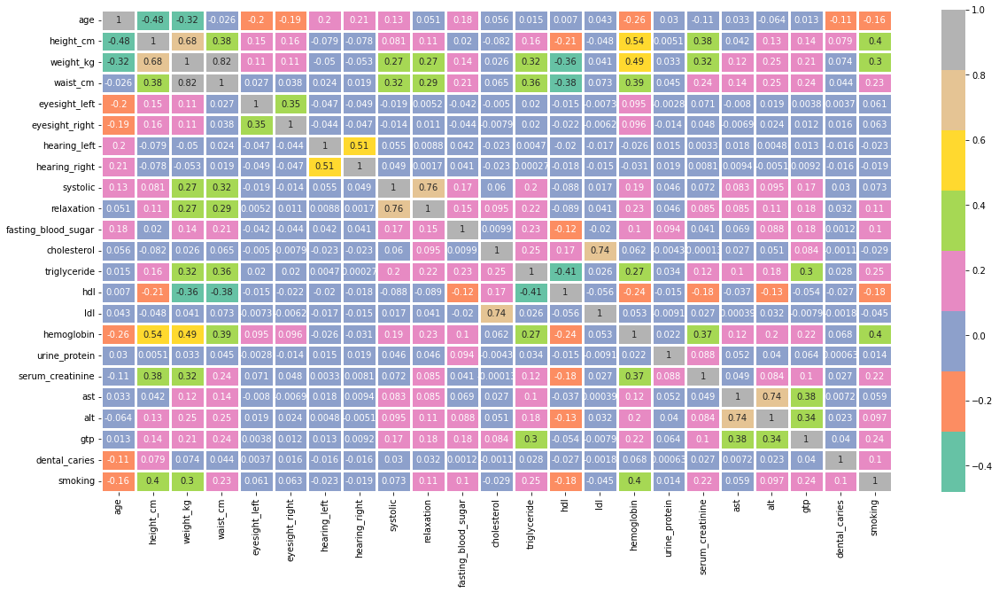

In [8]:
plt.figure(figsize = [20, 10], clear = True, facecolor = "white")
sns.heatmap(df.corr(), annot = True, square = False, linewidths = 3,
            linecolor = "white", cmap = "Set2");

<a id="5.2"></a>

#### <b>5.2 <span style='color:#4a8fdd'>|</span> Pie Chart</b>

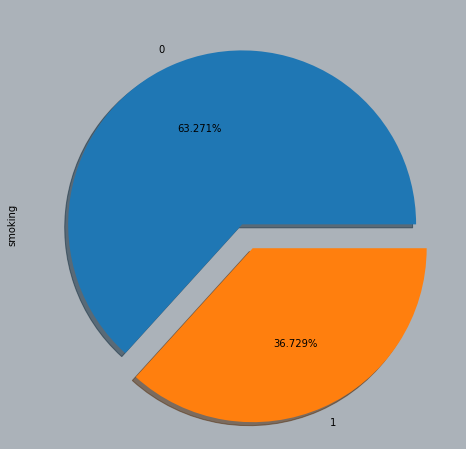

In [9]:
plt.figure(figsize = [8, 8], clear = True, facecolor = "#ABB2B9")
df["smoking"].value_counts().plot.pie(explode = [0, 0.15], autopct='%1.3f%%', shadow = True);

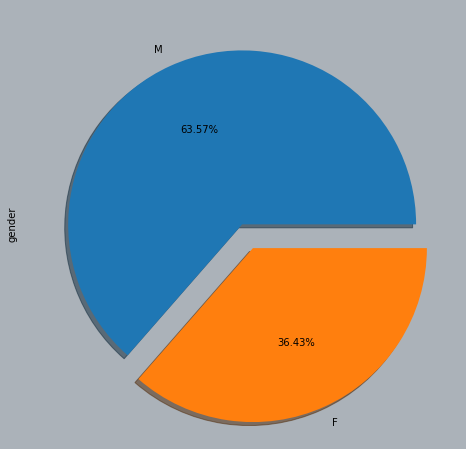

In [10]:
plt.figure(figsize = [8, 8], clear = True, facecolor = "#ABB2B9")
df["gender"].value_counts().plot.pie(explode = [0, 0.15], autopct='%1.2f%%', shadow = True);

<a id="5.3"></a>

#### <b>5.3 <span style='color:#4a8fdd'>|</span> Barplot</b>

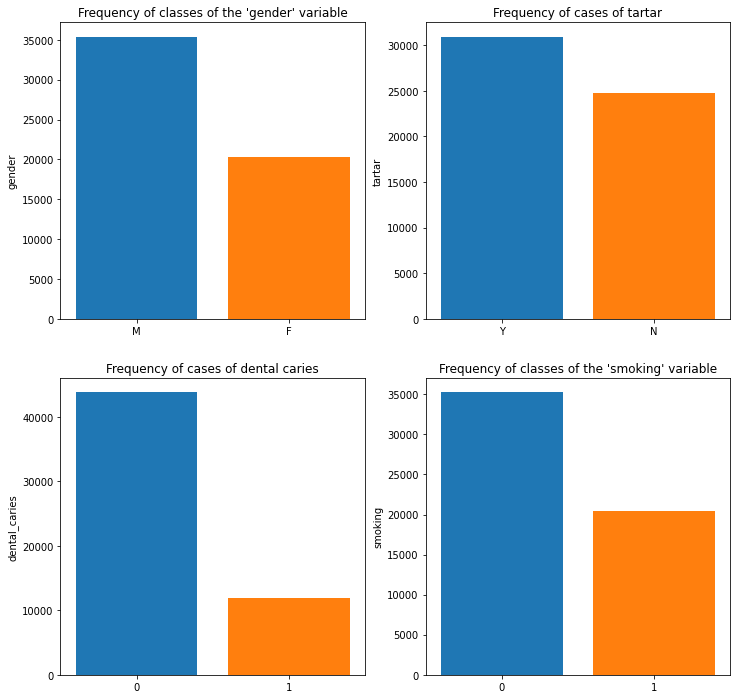

In [11]:
fig, axes = plt.subplots(2, 2, figsize = (12, 12))
axes = axes.flatten()

sns.barplot(ax = axes[0],
            x = df["gender"].value_counts().index,
            y = df["gender"].value_counts(),
            data = df, saturation = 1).set(title = "Frequency of classes of the 'gender' variable");

sns.barplot(ax = axes[1],
            x = df["tartar"].value_counts().index,
            y = df["tartar"].value_counts(),
            data = df, saturation = 1).set(title = "Frequency of cases of tartar");

sns.barplot(ax = axes[2],
            x = df["dental_caries"].value_counts().index,
            y = df["dental_caries"].value_counts(),
            data = df, saturation = 1).set(title = "Frequency of cases of dental caries");

sns.barplot(ax = axes[3],
            x = df["smoking"].value_counts().index,
            y = df["smoking"].value_counts(),
            data = df, saturation = 1).set(title = "Frequency of classes of the 'smoking' variable");

<a id="5.4"></a>

#### <b>5.4 <span style='color:#4a8fdd'>|</span> Catplot</b>

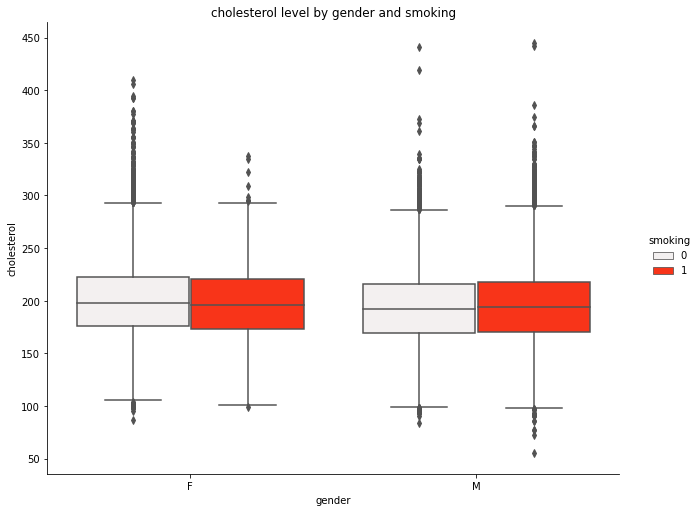

In [12]:
sns.catplot(x = "gender",
            y = "cholesterol",
            kind = "box",
            hue = "smoking",
            color = '#F83419',
            data = df, saturation = 1, height = 7, aspect = 1.3,
            margin_titles = True).set(title = "cholesterol level by gender and smoking");

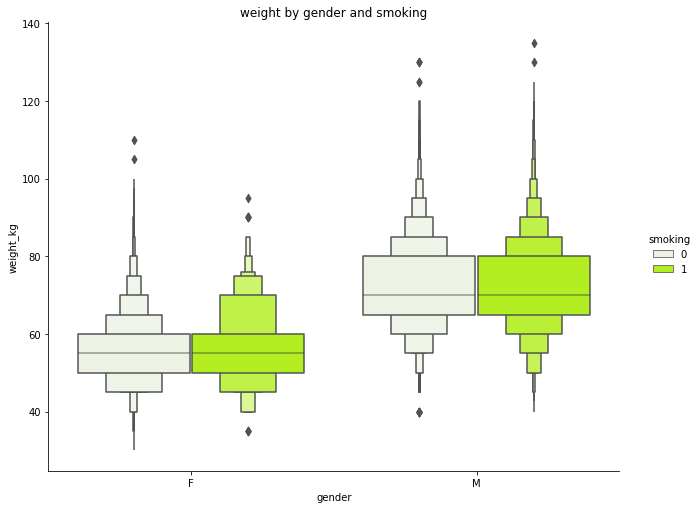

In [13]:
sns.catplot(x = "gender",
            y = "weight_kg",
            hue = "smoking",
            kind = "boxen",
            color = '#B3EE22',
            data = df, saturation = 1, height = 7, aspect = 1.3,
            margin_titles = True).set(title = "weight by gender and smoking");

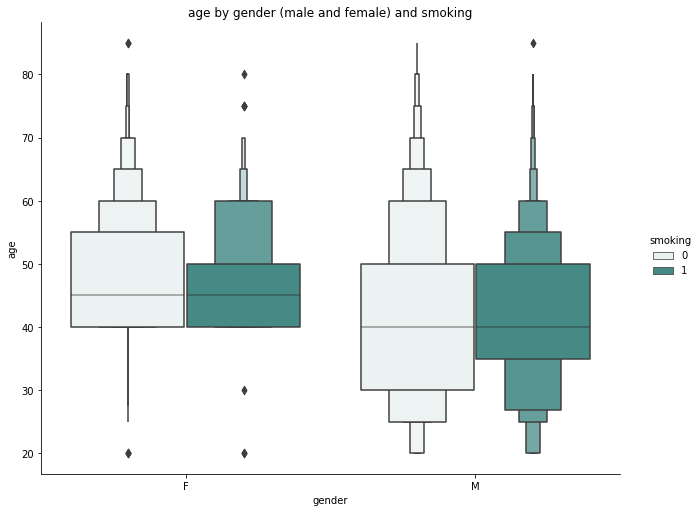

In [14]:
sns.catplot(x = "gender",
            y = "age",
            hue = "smoking",
            kind = "boxen",
            color = '#468A85',
            data = df, saturation = 1, height = 7, aspect = 1.3,
            margin_titles = True).set(title = "age by gender (male and female) and smoking");

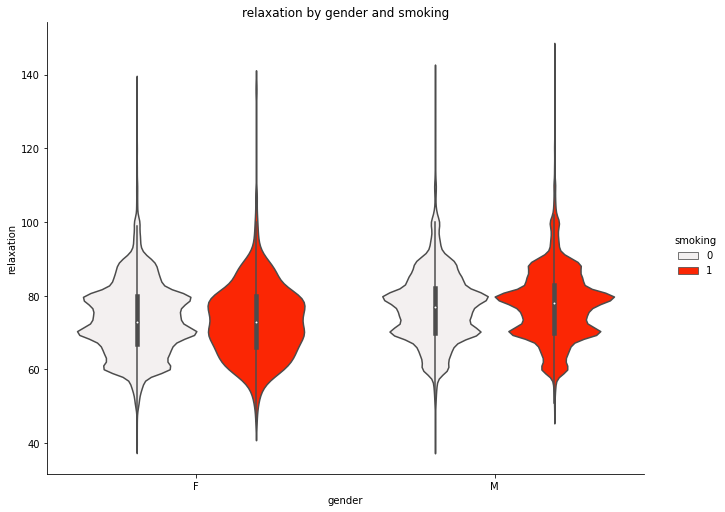

In [15]:
sns.catplot(x = "gender",
            y = "relaxation",
            hue = "smoking",
            kind = "violin",
            color = '#FB2604',
            data = df, saturation = 1, height = 7, aspect = 1.35,
            margin_titles = True).set(title = "relaxation by gender and smoking");

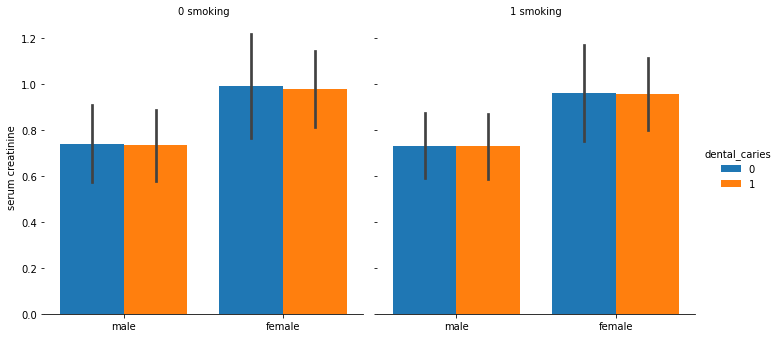

In [16]:
g = sns.catplot(x = "gender", y = "serum_creatinine", col = "smoking", 
                hue = "dental_caries",
                data = df,
                saturation = 1,
                kind = "bar",
                ci = "sd",
                aspect = 0.99)

(g.set_axis_labels("", "serum creatinine").set_xticklabels(["male", "female"])
  .set_titles("{col_name} {col_var}").despine(left = True));  

<a id="5.5"></a>

#### <b>5.5 <span style='color:#4a8fdd'>|</span> Pairplot</b>

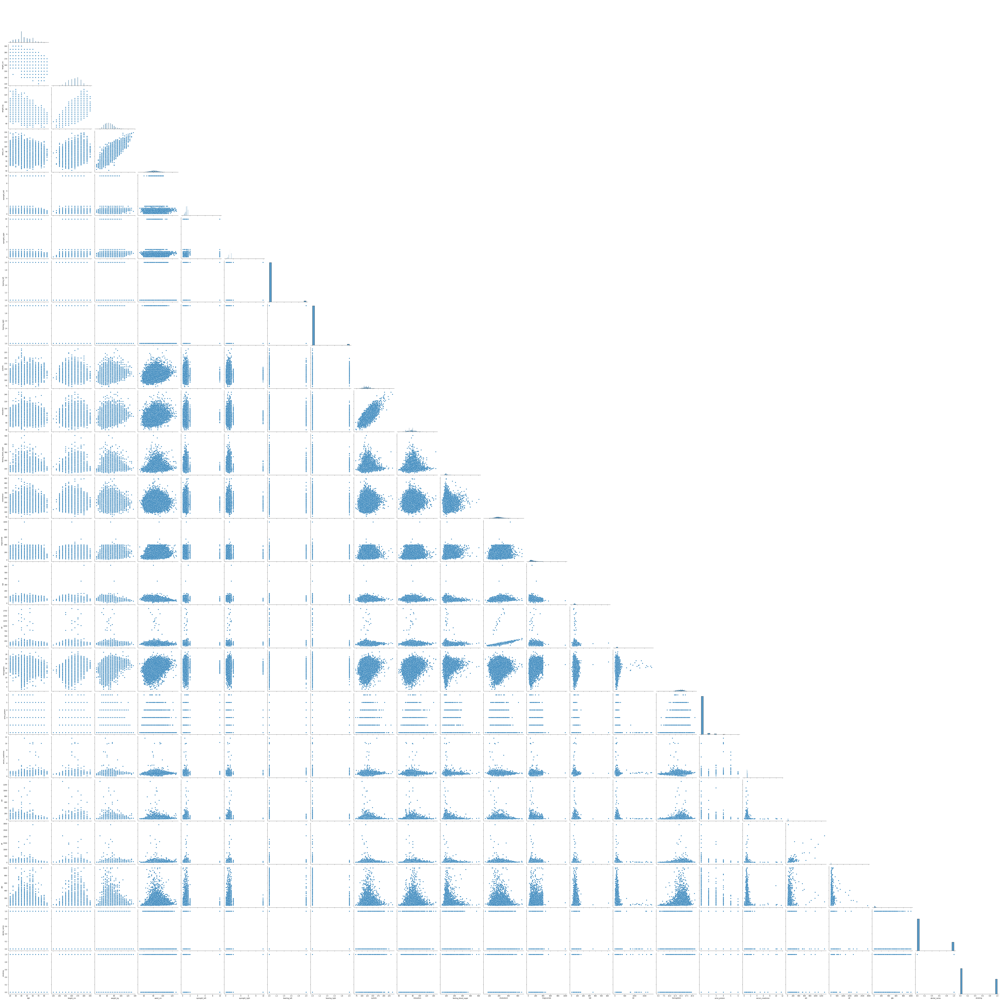

In [17]:
sns.pairplot(df, diag_kind = "hist", height = 4, aspect = 1, corner = True);

<a id="5.6"></a>

#### <b>5.6 <span style='color:#4a8fdd'>|</span> Scatterplot</b>

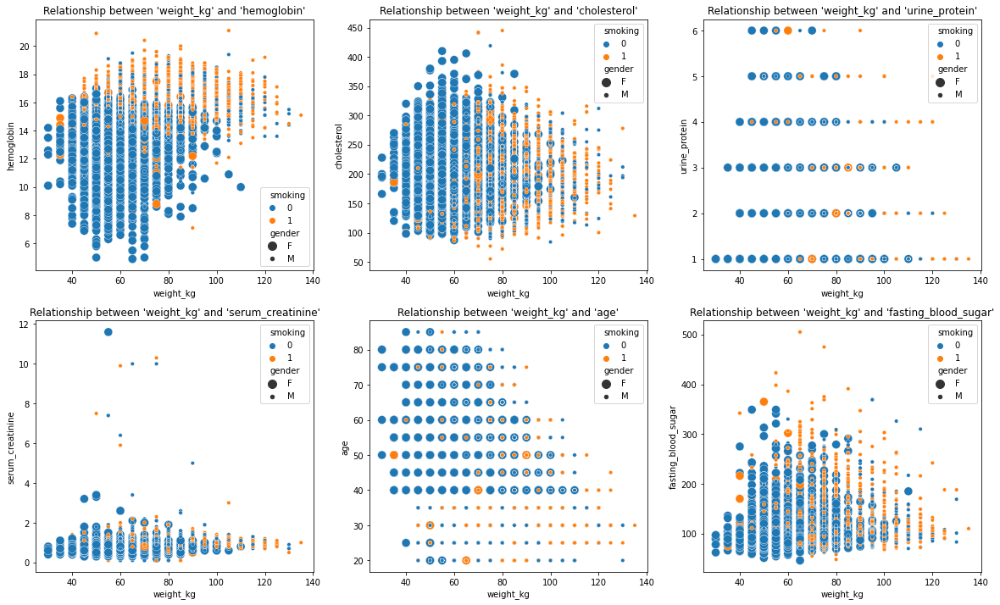

In [18]:
fig, axes = plt.subplots(2, 3, figsize = (20, 12))
axes = axes.flatten()

sns.scatterplot(ax = axes[0], x = "weight_kg", y = "hemoglobin",
                hue = "smoking", size = "gender", sizes=(20, 100), legend="full",
                data = df).set(title = "Relationship between 'weight_kg' and 'hemoglobin'");

sns.scatterplot(ax = axes[1], x = "weight_kg", y = "cholesterol", hue = "smoking",
                size = "gender", sizes=(20, 100), legend="full",
                data = df).set(title = "Relationship between 'weight_kg' and 'cholesterol'");

sns.scatterplot(ax = axes[2], x = "weight_kg", y = "urine_protein", hue = "smoking",
                size = "gender", sizes=(20, 100), legend="full",
                data = df).set(title = "Relationship between 'weight_kg' and 'urine_protein'");

sns.scatterplot(ax = axes[3], x = "weight_kg", y = "serum_creatinine", hue = "smoking",
                size = "gender", sizes=(20, 100), legend="full",
                data = df).set(title = "Relationship between 'weight_kg' and 'serum_creatinine'");

sns.scatterplot(ax = axes[4], x = "weight_kg", y = "age", hue = "smoking",
                size = "gender", sizes=(20, 100), legend="full",
                data = df).set(title = "Relationship between 'weight_kg' and 'age'");

sns.scatterplot(ax = axes[5], x = "weight_kg", y = "fasting_blood_sugar", hue = "smoking",
                size = "gender", sizes=(20, 100), legend="full",
                data = df).set(title = "Relationship between 'weight_kg' and 'fasting_blood_sugar'");

<a id="5.7"></a>

#### <b>5.7 <span style='color:#4a8fdd'>|</span> Distplot</b>

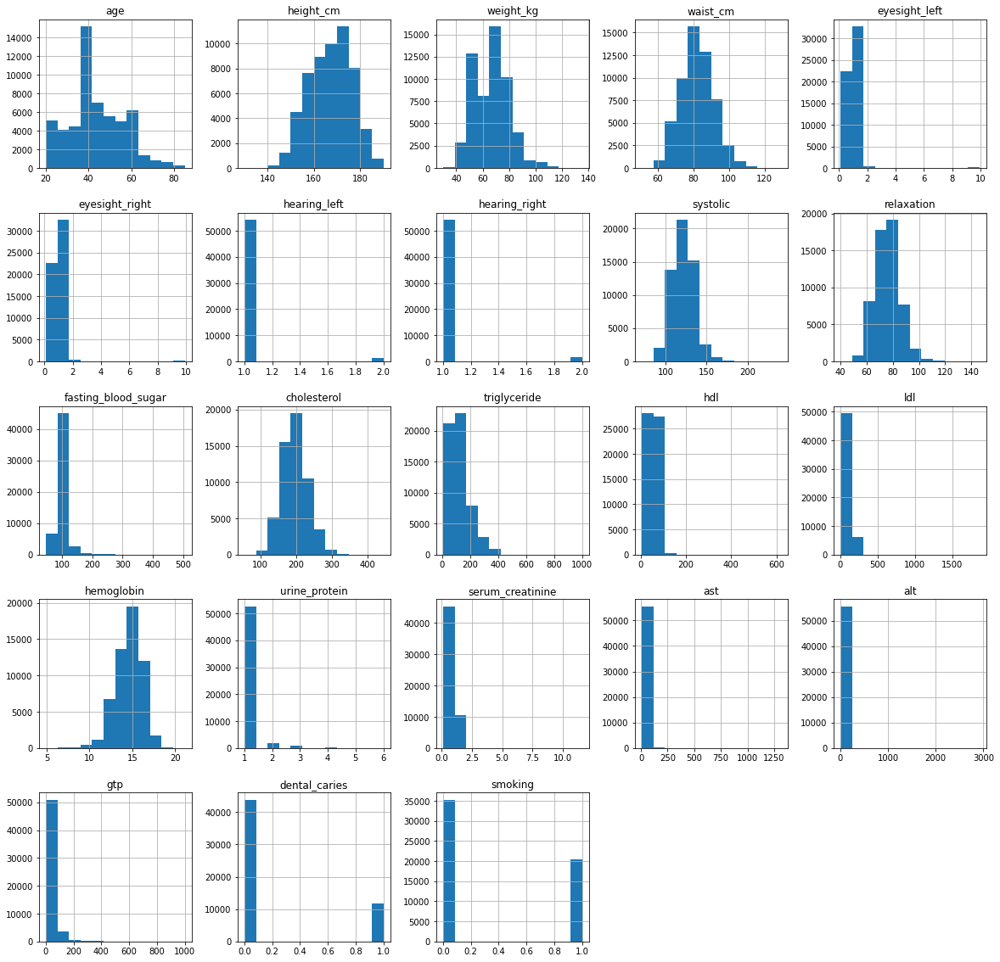

In [19]:
df.hist(figsize = (20, 20), bins = 12, legend = False);

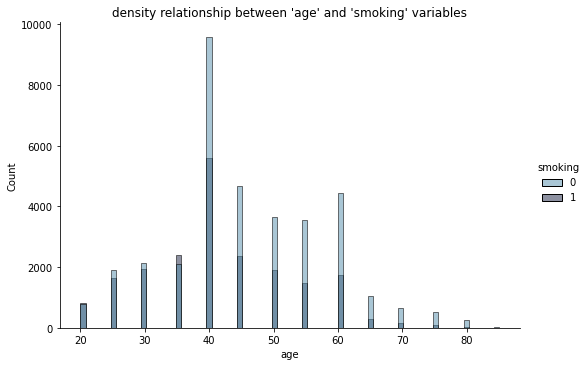

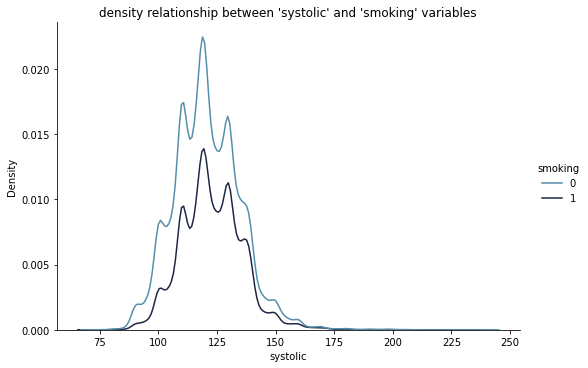

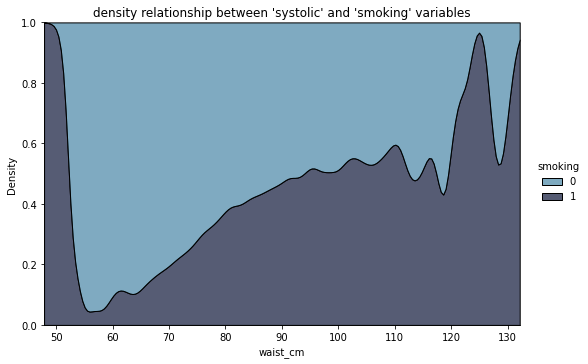

In [20]:
sns.displot(
    data = df, x = "age", hue = "smoking",
    kind = "hist", height = 5, aspect = 1.5,
    palette="ch:rot=-.25,hue=1,light=.50").set(title =  "density relationship between 'age' and 'smoking' variables");


sns.displot(
    data = df, x = "systolic", hue = "smoking",
    kind = "kde", height = 5, aspect = 1.5,
    palette="ch:rot=-.25,hue=1,light=.50").set(title = "density relationship between 'systolic' and 'smoking' variables");


sns.displot(
    data = df, x = "waist_cm", hue = "smoking",
    kind = "kde", height = 5, aspect = 1.5, multiple="fill",
    palette="ch:rot=-.25,hue=1,light=.50").set(title = "density relationship between 'systolic' and 'smoking' variables");

<a id="5.8"></a>

#### <b>5.8 <span style='color:#4a8fdd'>|</span> Regplot</b>

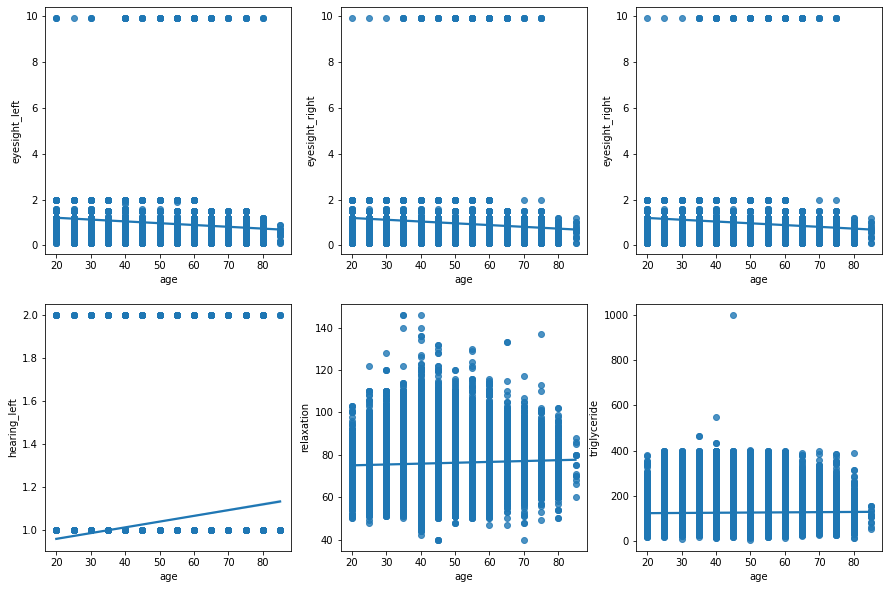

In [21]:
fig, axes = plt.subplots(2, 3, figsize = (15, 10))
axes = axes.flatten()

sns.regplot(ax = axes[0], x = "age", y = "eyesight_left", data = df);
sns.regplot(ax = axes[1], x = "age", y = "eyesight_right", data = df);
sns.regplot(ax = axes[2], x = "age", y = "eyesight_right", data = df);
sns.regplot(ax = axes[3], x = "age", y = "hearing_left", data = df);
sns.regplot(ax = axes[4], x = "age", y = "relaxation", data = df);
sns.regplot(ax = axes[5], x = "age", y = "triglyceride", data = df);

<a id="5.9"></a>

#### <b>5.9 <span style='color:#4a8fdd'>|</span> 2D Histogram</b>

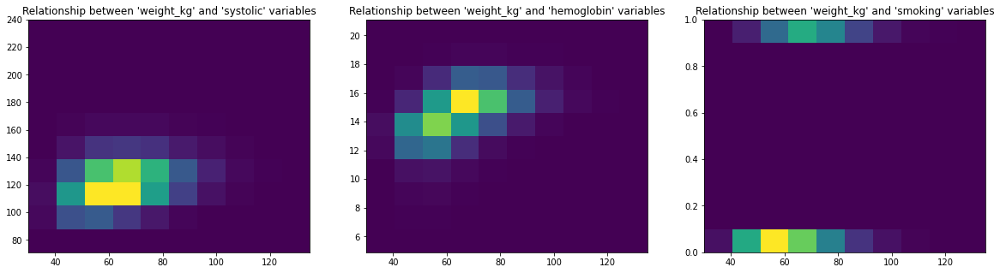

In [22]:
fig, ax = plt.subplots(1, 3, figsize = (20, 5))

ax[0].hist2d(df["weight_kg"], df["systolic"])
ax[0].set_title("Relationship between 'weight_kg' and 'systolic' variables")

ax[1].hist2d(df["weight_kg"], df["hemoglobin"])
ax[1].set_title("Relationship between 'weight_kg' and 'hemoglobin' variables")

ax[2].hist2d(df["weight_kg"], df["smoking"])
ax[2].set_title("Relationship between 'weight_kg' and 'smoking' variables")

plt.show()

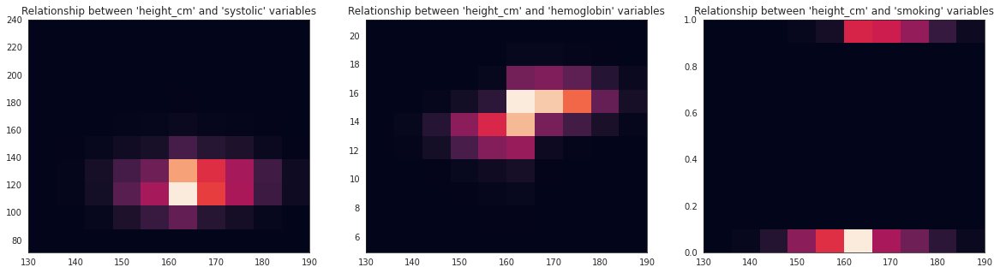

In [23]:
sns.set_style("white")

fig, ax = plt.subplots(1, 3, figsize = (20, 5))

ax[0].hist2d(df["height_cm"], df["systolic"])
ax[0].set_title("Relationship between 'height_cm' and 'systolic' variables")

ax[1].hist2d(df["height_cm"], df["hemoglobin"])
ax[1].set_title("Relationship between 'height_cm' and 'hemoglobin' variables")

ax[2].hist2d(df["height_cm"], df["smoking"])
ax[2].set_title("Relationship between 'height_cm' and 'smoking' variables")
             
plt.show()

<a id="5.10"></a>

#### <b>5.10 <span style='color:#4a8fdd'>|</span> Pandas Crosstab</b>

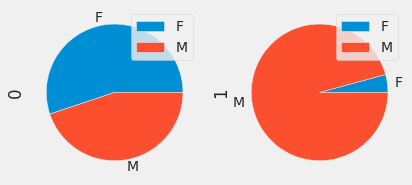

In [24]:
plt.style.use('fivethirtyeight')

pd.crosstab(df['gender'], df['smoking'],
            normalize = True).plot(kind = "pie", subplots = True, stacked=True);

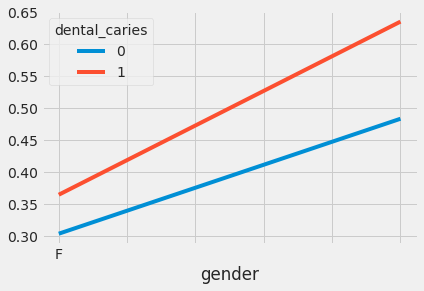

In [25]:
pd.crosstab(df['gender'], df['dental_caries'],
            normalize = True).plot(kind = "line", stacked=True);

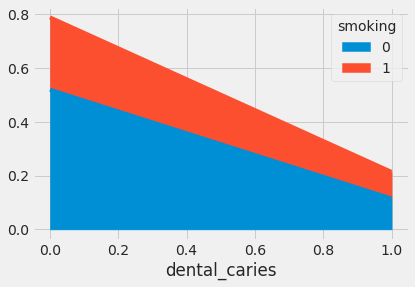

In [26]:
pd.crosstab(df['dental_caries'], df['smoking'],
            normalize = True).plot(kind = "area", stacked=True);

<a id="5.11"></a>

#### <b>5.11 <span style='color:#4a8fdd'>|</span>Smooth Kernel Density With Marginal Histograms</b>

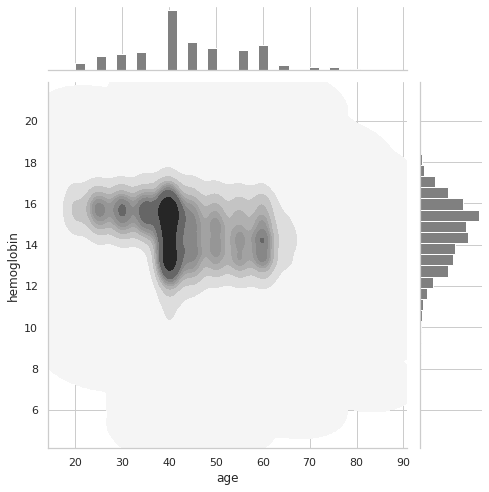

In [27]:
sns.set_theme(style = "whitegrid")

g = sns.JointGrid(data = df,
                  size = 7,
                  height = 5,
                  x = "age",
                  y = "hemoglobin",
                  space = 0.2)

g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "binary")
g.plot_marginals(sns.histplot, color = "#808080", alpha = 1, bins = 30);

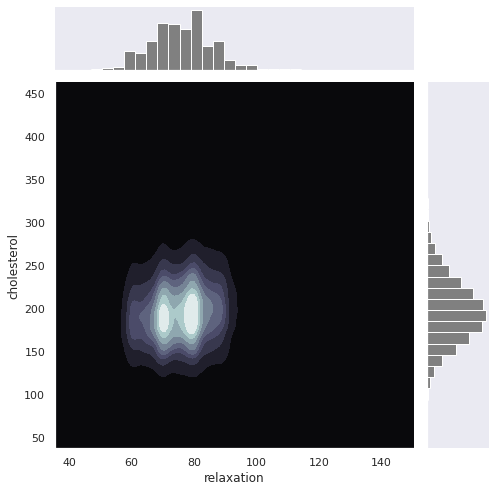

In [28]:
sns.set_theme(style = "dark")

g = sns.JointGrid(data = df,
                  size = 7,
                  height = 5,
                  x = "relaxation",
                  y = "cholesterol",
                  space = 0.2)

g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "bone")
g.plot_marginals(sns.histplot, color = "#808080", alpha = 1, bins = 30);

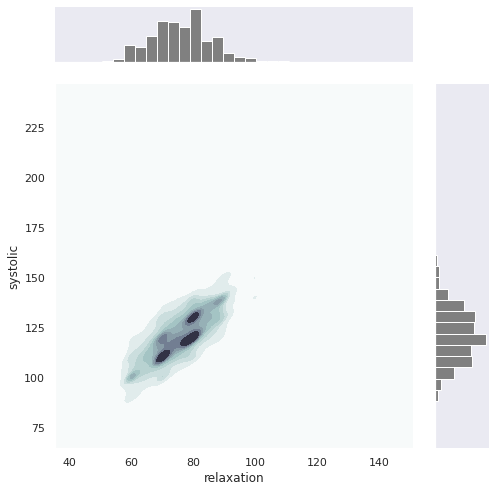

In [29]:
g = sns.JointGrid(data = df,
                  size = 7,
                  height = 5,
                  x = "relaxation",
                  y = "systolic",
                  space = 0.4)

g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "bone_r")
g.plot_marginals(sns.histplot, color = "#808080", alpha = 1, bins = 30);

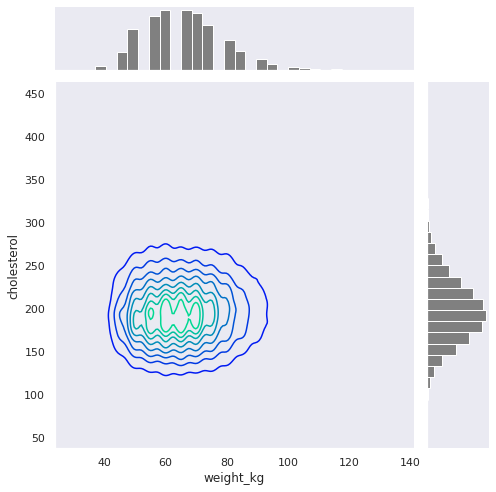

In [30]:
g = sns.JointGrid(data = df,
                  size = 7,
                  height = 5,
                  x = "weight_kg",
                  y = "cholesterol",
                  space = 0.2)

g.plot_joint(sns.kdeplot, fill = False, thresh = 0, cmap = "winter")
g.plot_marginals(sns.histplot, color = "#808080", alpha = 1, bins = 30);

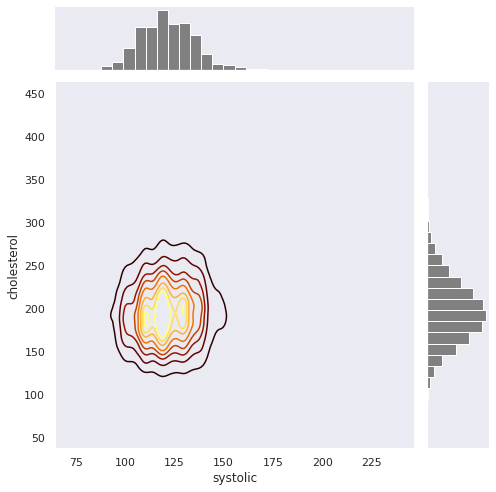

In [31]:
g = sns.JointGrid(data = df,
                  size = 7,
                  height = 5,
                  x = "systolic",
                  y = "cholesterol",
                  space = 0.2)

g.plot_joint(sns.kdeplot, fill = False, thresh = 0, cmap = "afmhot")
g.plot_marginals(sns.histplot, fill = True, color = "#808080", alpha = 1, bins = 30);

<a id="5.12"></a>

#### <b>5.12 <span style='color:#4a8fdd'>|</span>Visualization with Plotly Express</b>

In [32]:
fig = px.histogram(df, x = "age",
                   y = "cholesterol",
                   marginal = "box",
                   color = "smoking", hover_data  = df.columns)
fig.show()

In [33]:
fig = px.histogram(df, x = "age",
                   y = "cholesterol",
                   marginal = "violin",
                   color = "gender", hover_data  = df.columns)
fig.show()

In [34]:
fig = px.density_heatmap(df, x = "age", y = "hemoglobin", z = "cholesterol",
                        color_continuous_scale = "picnic", text_auto = True)
fig.show()

In [35]:
fig = px.ecdf(df, x = "relaxation", log_x = True, log_y = True, color = "smoking", marginal = "histogram")
fig.show()

In [36]:
fig = px.ecdf(df, x = "hemoglobin", log_x = True, log_y = True, color = "smoking", marginal = "histogram")
fig.show()

In [37]:
fig = px.ecdf(df, x = "cholesterol", log_x = True, log_y = True, color = "smoking", marginal = "histogram")
fig.show()

In [38]:
fig = px.ecdf(df, x = "cholesterol", log_x = True, log_y = True, color = "gender", marginal = "histogram")
fig.show()

In [39]:
fig = px.scatter_3d(df, 
                    x = "hemoglobin",
                    y = "age",
                    z = "cholesterol",
                    color="smoking")
fig.show();

<a id="6"></a>

## <b>6 <span style='color:#4a8fdd'>|</span> DATASET PREPROCESSING</b>

<a id="6.1"></a>

#### <b>6.1 <span style='color:#4a8fdd'>|</span>Look at dataset and drop outliers</b>

In [40]:
df.head(n = 10).style.background_gradient(cmap = "Oranges")

,gender,age,height_cm,weight_kg,waist_cm,eyesight_left,eyesight_right,hearing_left,hearing_right,systolic,relaxation,fasting_blood_sugar,cholesterol,triglyceride,hdl,ldl,hemoglobin,urine_protein,serum_creatinine,ast,alt,gtp,oral,dental_caries,tartar,smoking
0,F,40,155,60,81.300000,1.200000,1.000000,1.000000,1.000000,114.000000,73.000000,94.000000,215.000000,82.000000,73.000000,126.000000,12.900000,1.000000,0.700000,18.000000,19.000000,27.000000,Y,0,Y,0
1,F,40,160,60,81.000000,0.800000,0.600000,1.000000,1.000000,119.000000,70.000000,130.000000,192.000000,115.000000,42.000000,127.000000,12.700000,1.000000,0.600000,22.000000,19.000000,18.000000,Y,0,Y,0
2,M,55,170,60,80.000000,0.800000,0.800000,1.000000,1.000000,138.000000,86.000000,89.000000,242.000000,182.000000,55.000000,151.000000,15.800000,1.000000,1.000000,21.000000,16.000000,22.000000,Y,0,N,1
3,M,40,165,70,88.000000,1.500000,1.500000,1.000000,1.000000,100.000000,60.000000,96.000000,322.000000,254.000000,45.000000,226.000000,14.700000,1.000000,1.000000,19.000000,26.000000,18.000000,Y,0,Y,0
4,F,40,155,60,86.000000,1.000000,1.000000,1.000000,1.000000,120.000000,74.000000,80.000000,184.000000,74.000000,62.000000,107.000000,12.500000,1.000000,0.600000,16.000000,14.000000,22.000000,Y,0,N,0
5,M,30,180,75,85.000000,1.200000,1.200000,1.000000,1.000000,128.000000,76.000000,95.000000,217.000000,199.000000,48.000000,129.000000,16.200000,1.000000,1.200000,18.000000,27.000000,33.000000,Y,0,Y,0
6,M,40,160,60,85.500000,1.000000,1.000000,1.000000,1.000000,116.000000,82.000000,94.000000,226.000000,68.000000,55.000000,157.000000,17.000000,1.000000,0.700000,21.000000,27.000000,39.000000,Y,1,Y,1
7,M,45,165,90,96.000000,1.200000,1.000000,1.000000,1.000000,153.000000,96.000000,158.000000,222.000000,269.000000,34.000000,134.000000,15.000000,1.000000,1.300000,38.000000,71.000000,111.000000,Y,0,Y,0
8,F,50,150,60,85.000000,0.700000,0.800000,1.000000,1.000000,115.000000,74.000000,86.000000,210.000000,66.000000,48.000000,149.000000,13.700000,1.000000,0.800000,31.000000,31.000000,14.000000,Y,0,N,0
9,M,45,175,75,89.000000,1.000000,1.000000,1.000000,1.000000,113.000000,64.000000,94.000000,198.000000,147.000000,43.000000,126.000000,16.000000,1.000000,0.800000,26.000000,24.000000,63.000000,Y,0,N,0


In [41]:
def outlier_detection(df, n, columns):
    rows = []
    will_drop_train = []
    for col in columns:
        Q1 = np.nanpercentile(df[col], 25)
        Q3 = np.nanpercentile(df[col], 75)
        IQR = Q3 - Q1
        outlier_point = 1.5 * IQR
        rows.extend(df[(df[col] < Q1 - outlier_point)|(df[col] > Q3 + outlier_point)].index)
    for r, c in Counter(rows).items():
        if c >= n: will_drop_train.append(r)
    return will_drop_train

will_drop_train = outlier_detection(df, 5, df.select_dtypes(["float", "int"]).columns)
will_drop_train[0:5]

[44, 3368, 3592, 4171, 4738]

In [42]:
df.drop(will_drop_train, inplace = True, axis = 0)

<a id="6.2"></a>

#### <b>6.2 <span style='color:#4a8fdd'>|</span> Encode Categoric Variables</b>

In [43]:
lbe = LabelEncoder()
lbe.fit_transform(df["gender"])
df["gender"] = lbe.fit_transform(df["gender"])

In [44]:
lbe = LabelEncoder()
lbe.fit_transform(df["tartar"])
df["tartar"] = lbe.fit_transform(df["tartar"])

In [45]:
lbe = LabelEncoder()
lbe.fit_transform(df["oral"])
df["oral"] = lbe.fit_transform(df["oral"])

<a id="6.3"></a>

#### <b>6.3 <span style='color:#4a8fdd'>|</span>Select Dependent (label) and Independent (estimator) Variables</b>

In [46]:
# select dependent variable (label)
y = df["smoking"]

# select independent variable (estimator)
x = df.drop("smoking", axis = 1)

<a id="6.4"></a>

#### <b>6.4 <span style='color:#4a8fdd'>|</span> Split the Dataset into Train and Test Sets</b>

In [47]:
x_train, x_test, y_train, y_test = train_test_split(x, y,
                                                    test_size = 0.10,
                                                    shuffle = True,
                                                    random_state = 1)

<a id="6.5"></a>

#### <b>6.5 <span style='color:#4a8fdd'>|</span> Standardization process</b>

In [48]:
scaler = MinMaxScaler()
scaler.fit(x_train)
x_train = scaler.transform(x_train)
x_test = scaler.transform(x_test)

<a id="7"></a>

## <b>7<span style='color:#4a8fdd'>|</span> BUILDING CLASSIFICATION MODELS</b>

> <a id="7.1"></a>

#### <b>7.1<span style='color:#4a8fdd'>|</span> Random Forest model</b>

In [49]:
rf_model = RandomForestClassifier(n_estimators = 2000)
rf_model.fit(x_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=2000, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_start=False)

> <a id="7.2"></a>

#### <b>7.2<span style='color:#4a8fdd'>|</span> Get Accuracy Score on Test Set</b>

In [50]:
y_pred = rf_model.predict(x_test)
accuracy_score(y_test, y_pred)

0.8420479302832244

> <a id="7.3"></a>

#### <b>7.3<span style='color:#4a8fdd'>|</span> Importance Level of Variables</b>

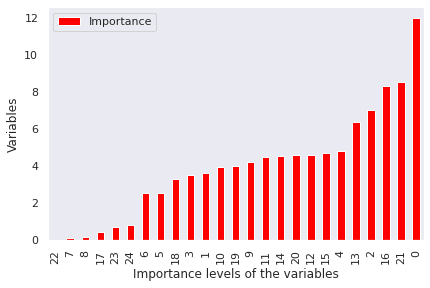

In [51]:
importance = pd.DataFrame({"Importance": rf_model.feature_importances_ * 100},
                         index = pd.DataFrame(x_train).columns)
importance.sort_values(by = "Importance", axis = 0,
                       ascending = True).plot(kind = "bar", color = "red")
plt.xlabel("Importance levels of the variables")
plt.ylabel("Variables");

> <a id="7.4"></a>

#### <b>7.4<span style='color:#4a8fdd'>|</span> Classification Report of Model</b>

In [52]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.86      0.87      3457
           1       0.78      0.81      0.79      2051

    accuracy                           0.84      5508
   macro avg       0.83      0.84      0.83      5508
weighted avg       0.84      0.84      0.84      5508



> <a id="7.5"></a>

#### <b>7.5<span style='color:#4a8fdd'>|</span> ROC AUC</b>

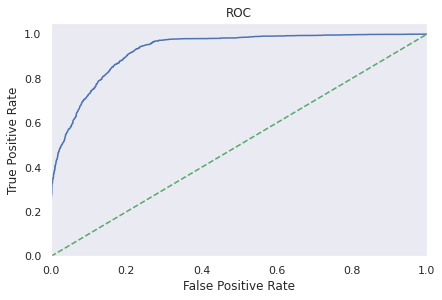

In [53]:
rf_roc_auc = roc_auc_score(y_test, rf_model.predict(x_test))
fpr, tpr, thresholds = roc_curve(y_test, rf_model.predict_proba(x_test)[:,1])

plt.figure()
plt.plot(fpr, tpr, label = 'AUC (area = %0.2f)' % rf_roc_auc)
plt.plot([0, 1], [0, 1],'g--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()

> <a id="7.6"></a>

#### <b>7.6<span style='color:#4a8fdd'>|</span> Visualization Confusion Matrix</b>

[[2980  477]
 [ 393 1658]]


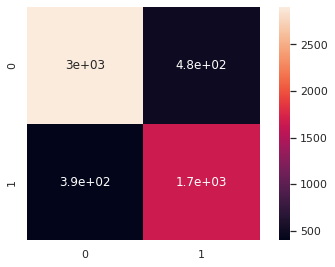

In [54]:
conf_mat = confusion_matrix(y_test, y_pred)
print(conf_mat)

sns.heatmap(conf_mat, square = True, annot = True, robust = True)
plt.show()

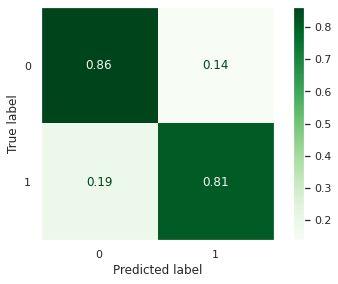

In [55]:
plot_confusion_matrix(rf_model, x_test, y_test, cmap = plt.cm.Greens, normalize = "true");

> <a id="7.7"></a>

#### <b>7.7<span style='color:#4a8fdd'>|</span> XGBoost model</b>

In [56]:
xgb_model = XGBClassifier(n_estimators = 2000)
xgb_model.fit(x_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=2000,
              n_jobs=0, num_parallel_tree=1, objective='binary:logistic',
              predictor='auto', random_state=0, reg_alpha=0, ...)

> <a id="7.8"></a>

#### <b>7.8<span style='color:#4a8fdd'>|</span> Get accuracy score of XGBoost model on test set</b>

In [57]:
y_pred = xgb_model.predict(x_test)
accuracy_score(y_test, y_pred)

0.8277051561365287

> <a id="7.9"></a>

#### <b>7.9<span style='color:#4a8fdd'>|</span> Comparison results with Pretty table</b>

In [58]:
x = PrettyTable()
print('\n')
print("Comparison of XGBoost and Random Forest Results")
x.field_names = ["Model", "Accuracy"]

x.add_row(["XGBoost model", round(accuracy_score(y_test, xgb_model.predict(x_test)), 2)])
x.add_row(["Random Forest model", round(accuracy_score(y_test, rf_model.predict(x_test)), 3)])

print(x)
print('\n')



Comparison of XGBoost and Random Forest Results
+---------------------+----------+
|        Model        | Accuracy |
+---------------------+----------+
|    XGBoost model    |   0.83   |
| Random Forest model |  0.842   |
+---------------------+----------+




> <a id="7.10"></a>

#### <b>7.10<span style='color:#4a8fdd'>|</span> Author's message</b>

# Thank you all 🙂